In [ ]:
!pip install gdown pandas osmnx geopandas shapely matplotlib

In [ ]:
import gdown
import pandas as pd

In [ ]:
id = '1rav6ae2zMj-sK9YhEEt8ep4xB3e1gLgu'
output = 'mundial.csv'
gdown.download(id=id, output=output, quiet=False)
mundial = pd.read_csv('mundial.csv')
mundial

Downloading...
From: https://drive.google.com/uc?id=1rav6ae2zMj-sK9YhEEt8ep4xB3e1gLgu
To: /content/mundial.csv
100%|██████████| 782/782 [00:00<00:00, 1.34MB/s]


,num,NOMGEO,ingresos_promedio,mundial
0,0,Azcapotzalco,2.666667,1679.736073
1,1,Coyoacán,3.000000,2686.508462
2,2,Cuajimalpa de Morelos,2.000000,634.516653
3,3,Gustavo A. Madero,1.777778,3040.100571
4,4,Iztacalco,2.750000,1621.970916
5,5,Iztapalapa,2.166667,5795.964386
6,6,La Magdalena Contreras,2.666667,962.366483
7,7,Milpa Alta,1.666667,370.875080
8,8,Álvaro Obregón,3.500000,3872.315491
9,9,Tláhuac,1.600000,914.819076


In [ ]:
a = "Álvaro_Obregón 259 1165 754 0 47 0 3 2228\nAzcapotzalco 0 0 199 117 255 67 58 696\nBenito_Juárez 331 764 1572 703 349 134 178 4031\nCoyoacán 0 481 186 230 120 0 0 1017\nCuajimalpa_de_Morelos 0 811 333 62 0 0 0 1206\nCuauhtémoc 2081 4635 6362 5911 3306 2772 996 26063\nGustavo_A._Madero 0 0 158 1287 362 227 51 2085\nIztacalco 59 0 334 291 105 0 89 878\nIztapalapa 0 96 801 257 304 105 0 1563\nLa_Magdalena_Contreras 0 286 0 0 0 0 0 286\nMiguel_Hidalgo 2294 1989 703 620 294 390 303 6593\nTláhuac 0 0 100 0 0 0 0 100\nTlalpan 317 295 337 437 43 0 0 1429\nVenustiano_Carranza 0 1266 753 335 476 161 133 3124\nXochimilco 0 0 183 54 54 0 11 302\nTotal 5341 11788 12775 10304 5715 3856 1822 51601"
x, lista, dic = a.split("\n"), [], {}
for i in x: lista.append(i.split(" "))
for i in lista:
  temp = []
  for j in i:
    try:  temp.append(int(j))
    except: continue
  dic[i[0].replace("_", " ")]=temp

data = pd.DataFrame.from_dict(dic).T

b="Granturismo 5Estrellas 4Estrellas 3Estrellas 2Estrellas 1Estrella Sinclasificar Total"
x = b.split()
data.columns = x
for i in range(len(x)):
    mundial[x[i]] = 0
"""for j in x:
    try:
      for i in range(len(mundial[j])):
        mundial[j][i] = dic[mundial['NOMGEO'][i]][i]
    except: continue"""

Cuartos_totales = data["Total"]["Total"]
T = 48600

data["cantidad de turistas"]= 0
for i in range(len(data["Total"])):
  data["cantidad de turistas"][i] = data["Total"][i]*T/Cuartos_totales

algo = data.to_csv("data.csv",index = True)
print(algo)

None


<ipython-input-58-40a8e61ee436>:29: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  data["cantidad de turistas"][i] = data["Total"][i]*T/Cuartos_totales
<ipython-input-58-40a8e61ee436>:29: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure th

In [ ]:
import osmnx as ox
import geopandas as gpd
from shapely.geometry import Point, LineString
import pandas as pd
import matplotlib.pyplot as plt

In [ ]:
puntos = {"Universidad metro": Point(-99.1739054, 19.3244753),
  "Barranca del Muerto": Point(-99.1896184, 19.3614459),
  "Taxqueña": Point(-99.1396585, 19.3437579),
  "Périferico oriente": Point(-99.0746315, 19.3177274),
  "Lazaro Cardenas": Point(-99.1447583, 19.4073685),
  "Entrada Parque Lira L1": Point(-99.1872701, 19.4026183),

          "Estadio": Point(-99.15070000, 19.3030000)}

<ipython-input-81-7eb5feea1f5b>:10: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  convex = combined.unary_union.envelope # using envelope instead of convex, otherwise it breaks the unary_union


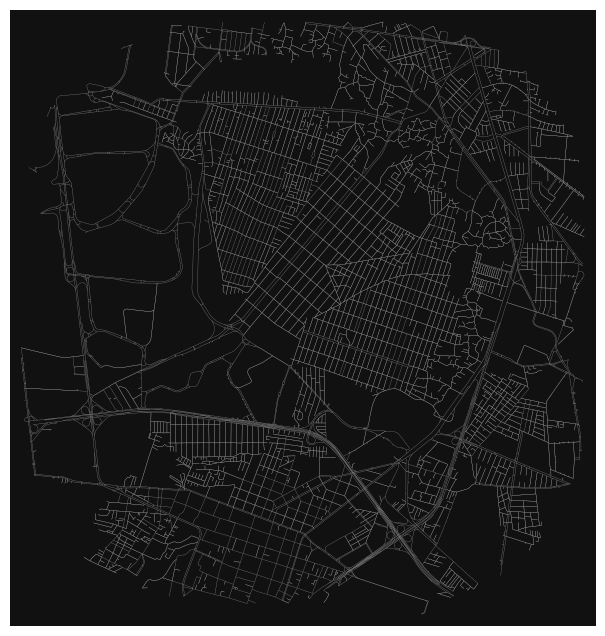

<ipython-input-81-7eb5feea1f5b>:10: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  convex = combined.unary_union.envelope # using envelope instead of convex, otherwise it breaks the unary_union


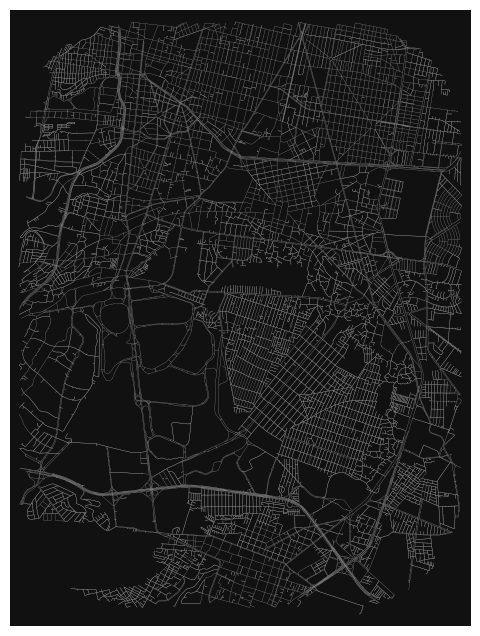

<ipython-input-81-7eb5feea1f5b>:10: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  convex = combined.unary_union.envelope # using envelope instead of convex, otherwise it breaks the unary_union


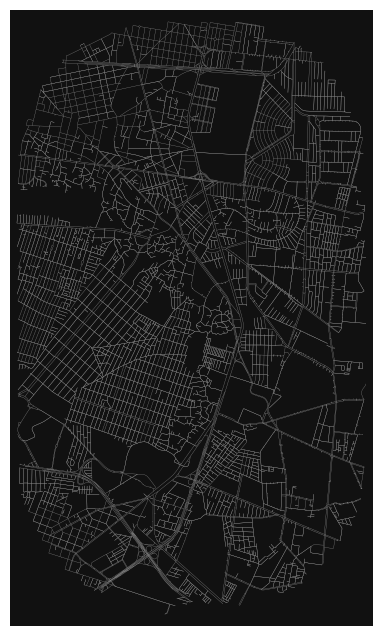

<ipython-input-81-7eb5feea1f5b>:10: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  convex = combined.unary_union.envelope # using envelope instead of convex, otherwise it breaks the unary_union


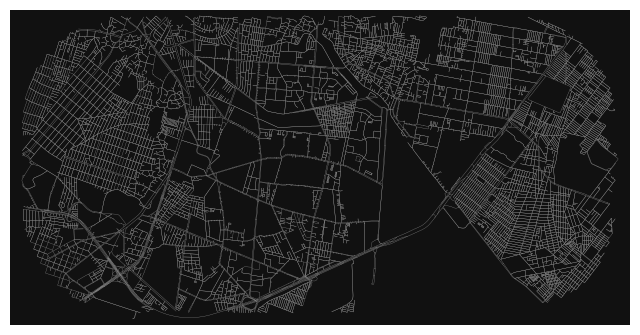

<ipython-input-81-7eb5feea1f5b>:10: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  convex = combined.unary_union.envelope # using envelope instead of convex, otherwise it breaks the unary_union


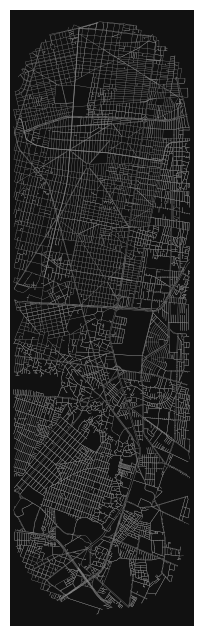

<ipython-input-81-7eb5feea1f5b>:10: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  convex = combined.unary_union.envelope # using envelope instead of convex, otherwise it breaks the unary_union


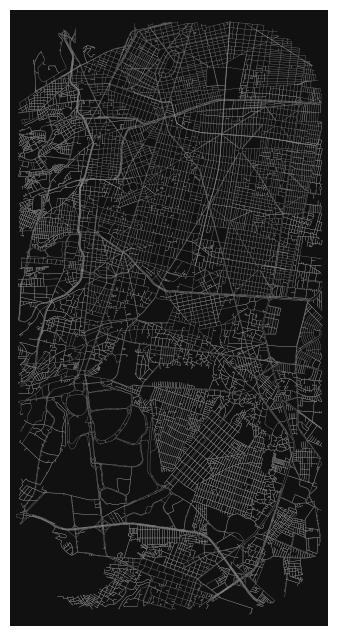

<ipython-input-81-7eb5feea1f5b>:10: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  convex = combined.unary_union.envelope # using envelope instead of convex, otherwise it breaks the unary_union


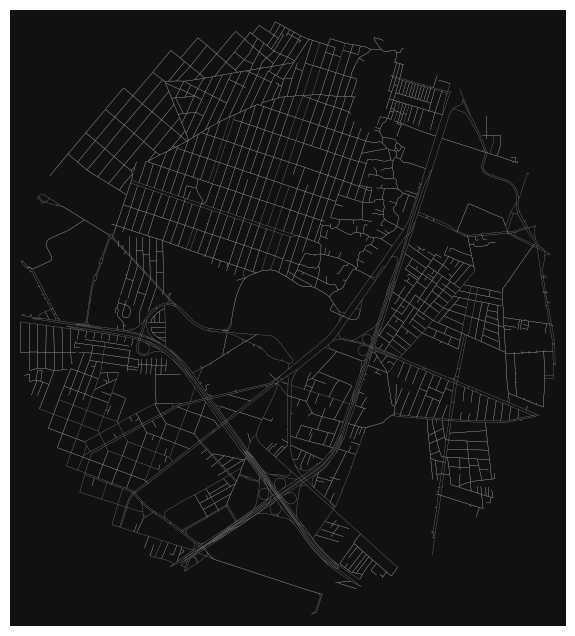

TypeError: 'module' object is not callable

In [ ]:
def get_graph_from_locations(origin, destination, network='drive'):
    '''
    network_type as drive, walk, bike
    origin gdf 4326
    destination gdf 4326
    '''
    # combine and area buffer
    combined = pd.concat([origin, destination])

    convex = combined.unary_union.envelope # using envelope instead of convex, otherwise it breaks the unary_union

    graph_extent = convex.buffer(0.02)

    graph = ox.graph_from_polygon(graph_extent, network_type= network)

    return graph
def nodes_to_route(graph_nodes, path_nodes):

    # Extract the route nodes of the graph
    route_nodes = graph_nodes.loc[path_nodes]

    # ---> note! If you have more routes, check for each one, to be removed in length is 1.  A path can not be built with only 1 node.

    # Create a LineString out of the route
    list_geom = route_nodes.geometry.to_list()
    path = LineString(list_geom)

    # Append the result into the GeoDataFrame
    route_df = gpd.GeoDataFrame( [[path]] )

    # Add a column name
    route_df.columns = ['geometry']

    # Set geometry
    route_df = route_df.set_geometry('geometry')

    # Set coordinate reference system
    route_df.crs = graph_nodes.crs

    # remove nans
    route_df = route_df.dropna(subset=['geometry'])

    return route_df

def compute_distance(shortest_path_gdf):
    '''
    Compute distance in EPSG:3387

    '''

    # project WGS84 to EPSG3387
    distances = shortest_path_gdf.to_crs("EPSG:3387").geometry.length

    # add
    shortest_path_gdf['distance'] = distances

    return shortest_path_gdf

route = []
for i in puntos.keys():
  origin_geom = Point(puntos[i])
  destination_geom = Point(puntos["Estadio"])

  origin =  gpd.GeoDataFrame(columns = ['name', 'geometry'], crs = 4326, geometry = 'geometry')
  origin.at[0, 'name'] = 'origin'
  origin.at[0, 'geometry'] =origin_geom

# create destination dataframe
  destination =  gpd.GeoDataFrame(columns = ['name', 'geometry'], crs = 4326, geometry = 'geometry')
  destination.at[0, 'name'] = 'destination'
  destination.at[0, 'geometry'] = destination_geom

  graph = get_graph_from_locations(origin, destination)

  fig, ax = ox.plot_graph(graph, node_size=0, edge_linewidth=0.2)

  closest_origin_node = ox.nearest_nodes(G=graph,
                                       X=origin_geom.x,
                                       Y=origin_geom.y)

# destination
  closest_destination_node = ox.nearest_nodes(G=graph,
                                           X=destination_geom.x,
                                           Y=destination_geom.y)

  routes = ox.shortest_path(graph,
                         orig = closest_origin_node,
                         dest = closest_destination_node,
                         weight = 'length')
  route.append(routes)
  # get all network nodes

fig, ax = ox.plot_graph_routes(G, routes,route_linewidth=6, node_size=0)
graph_nodes = ox.graph_to_gdfs(graph, edges=False)

"""# get the line geometries from osm nodes
for i in
  route_gdf = nodes_to_route(graph_nodes, route)

  route_distance_gdf = compute_distance(route_gdf)

  network = ox.graph_to_gdfs(graph, nodes=False)

# get only needed columns
  network_gdf = network.reset_index(drop=True)[['geometry']]
ax = network_gdf.plot(figsize=(12, 10), linewidth = 0.2, color='grey', zorder=0);

# origin and destination
origin.plot(ax=ax, markersize=46, alpha=0.8, color='blue', zorder=1)
destination.plot(ax=ax, markersize=46, alpha=0.8, color='green', zorder=2)

# route
route_distance_gdf.plot(ax=ax, linewidth = 3, color='red', alpha=0.4, zorder=3)

plt.axis(False);"""

In [ ]:
origin =  gpd.GeoDataFrame(columns = ['name', 'geometry'], crs = 4326, geometry = 'geometry')
origin.at[0, 'name'] = 'origin'
origin.at[0, 'geometry'] = puntos["Universidad metro"]

# create destination dataframe
destination =  gpd.GeoDataFrame(columns = ['name', 'geometry'], crs = 4326, geometry = 'geometry')
destination.at[0, 'name'] = 'destination'
destination.at[0, 'geometry'] = puntos["Estadio"]

In [ ]:
def get_graph_from_locations(origin, destination, network='drive'):
    '''
    network_type as drive, walk, bike
    origin gdf 4326
    destination gdf 4326
    '''
    # combine and area buffer
    combined = pd.concat([origin, destination])

    convex = combined.unary_union.envelope # using envelope instead of convex, otherwise it breaks the unary_union

    graph_extent = convex.buffer(0.02)

    graph = ox.graph_from_polygon(graph_extent, network_type= network)

    return graph

In [ ]:
graph = get_graph_from_locations(origin, destination)

<ipython-input-62-26e295b9f95d>:10: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  convex = combined.unary_union.envelope # using envelope instead of convex, otherwise it breaks the unary_union


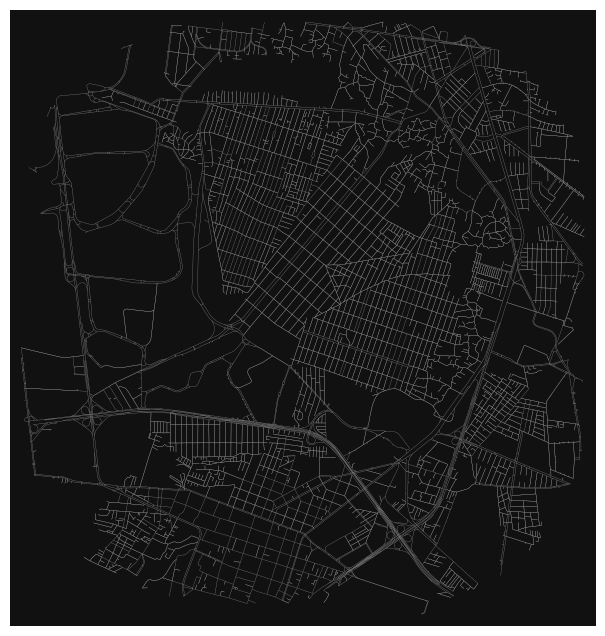

In [ ]:
fig, ax = ox.plot_graph(graph, node_size=0, edge_linewidth=0.2)

In [ ]:
# ------------- get closest nodes

# origin
closest_origin_node = ox.nearest_nodes(G=graph,
                                       X=puntos["Universidad metro"].x,
                                       Y=puntos["Universidad metro"].y)

# destination
closest_destination_node = ox.nearest_nodes(G=graph,
                                           X=puntos["Estadio"].x,
                                           Y=puntos["Estadio"].y)

In [ ]:
def nodes_to_route(graph_nodes, path_nodes):

    # Extract the route nodes of the graph
    route_nodes = graph_nodes.loc[path_nodes]

    # ---> note! If you have more routes, check for each one, to be removed in length is 1.  A path can not be built with only 1 node.

    # Create a LineString out of the route
    list_geom = route_nodes.geometry.to_list()
    path = LineString(list_geom)

    # Append the result into the GeoDataFrame
    route_df = gpd.GeoDataFrame( [[path]] )

    # Add a column name
    route_df.columns = ['geometry']

    # Set geometry
    route_df = route_df.set_geometry('geometry')

    # Set coordinate reference system
    route_df.crs = graph_nodes.crs

    # remove nans
    route_df = route_df.dropna(subset=['geometry'])
    return route_df
def compute_distance(shortest_path_gdf):
    '''
    Compute distance in EPSG:3387

    '''

    # project WGS84 to EPSG3387
    distances = shortest_path_gdf.to_crs("EPSG:3387").geometry.length

    # add
    shortest_path_gdf['distance'] = distances

    return shortest_path_gdf

/usr/local/lib/python3.11/dist-packages/geopandas/plotting.py:658: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots(figsize=figsize)


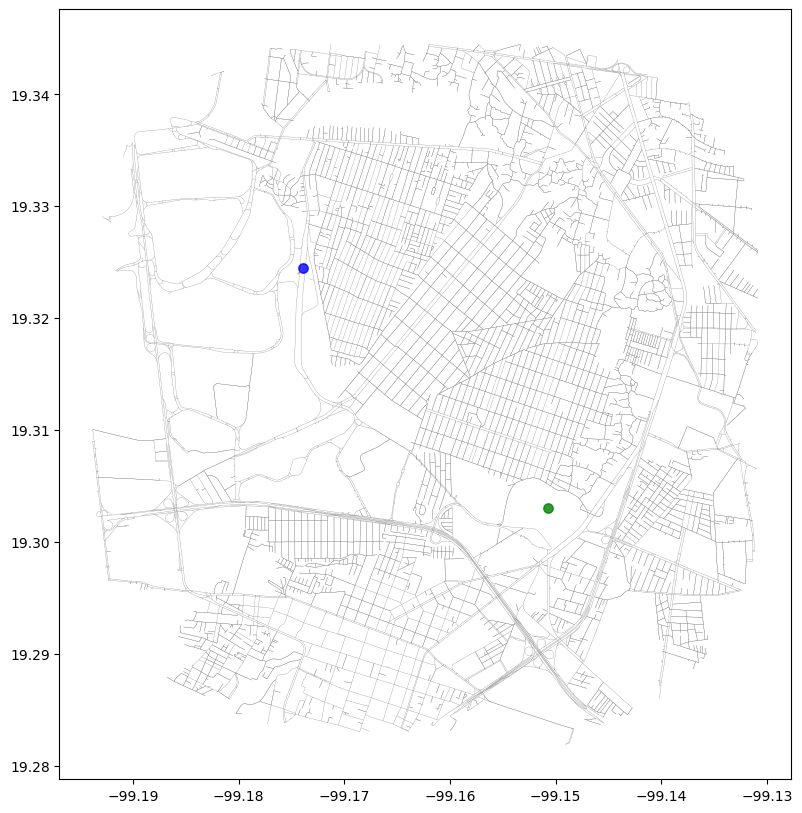

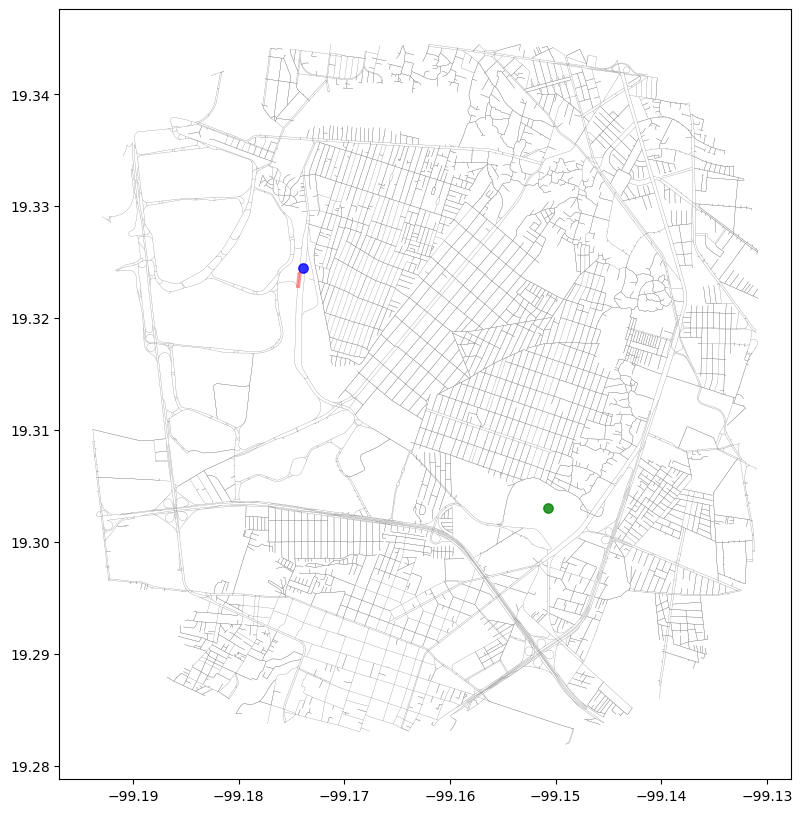

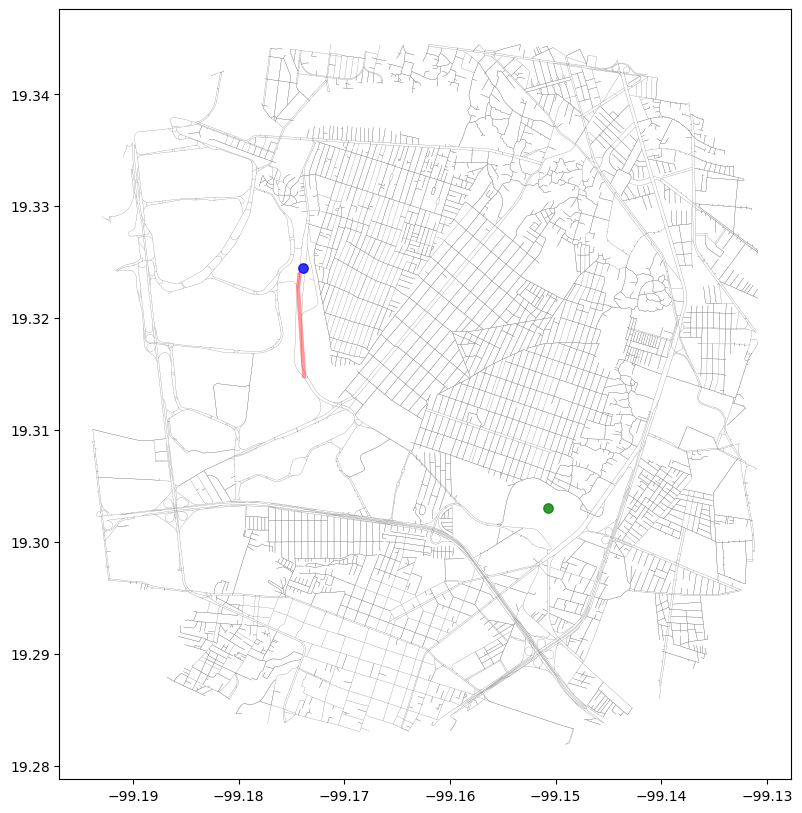

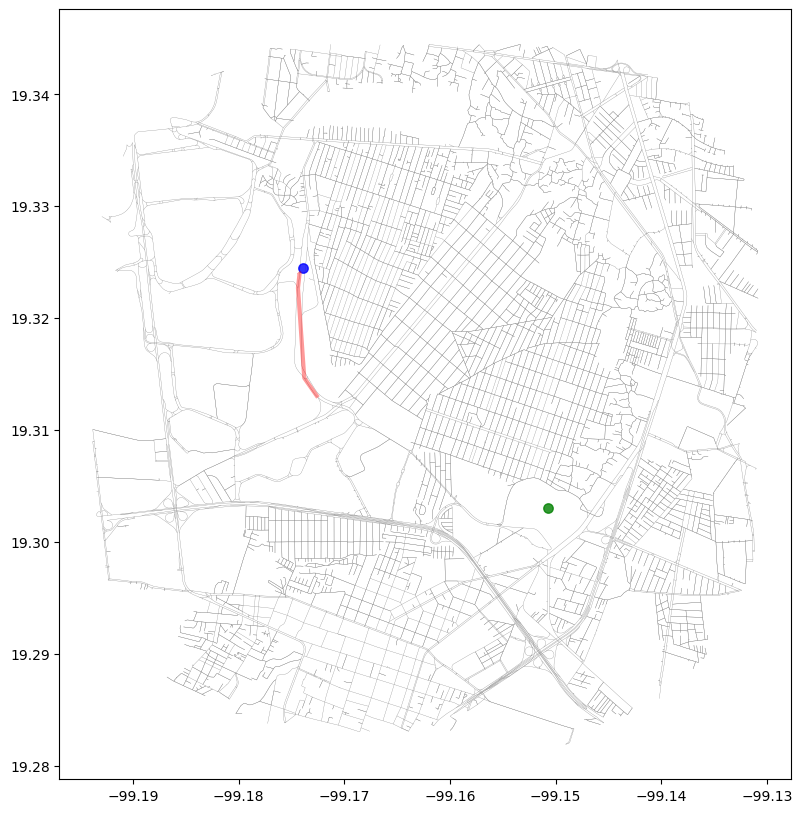

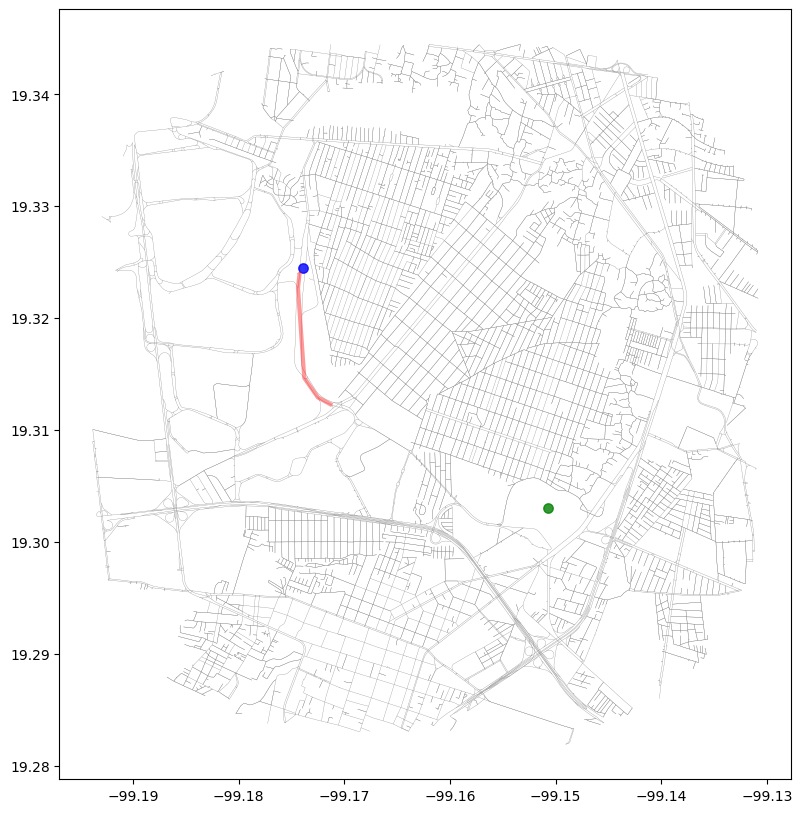

...

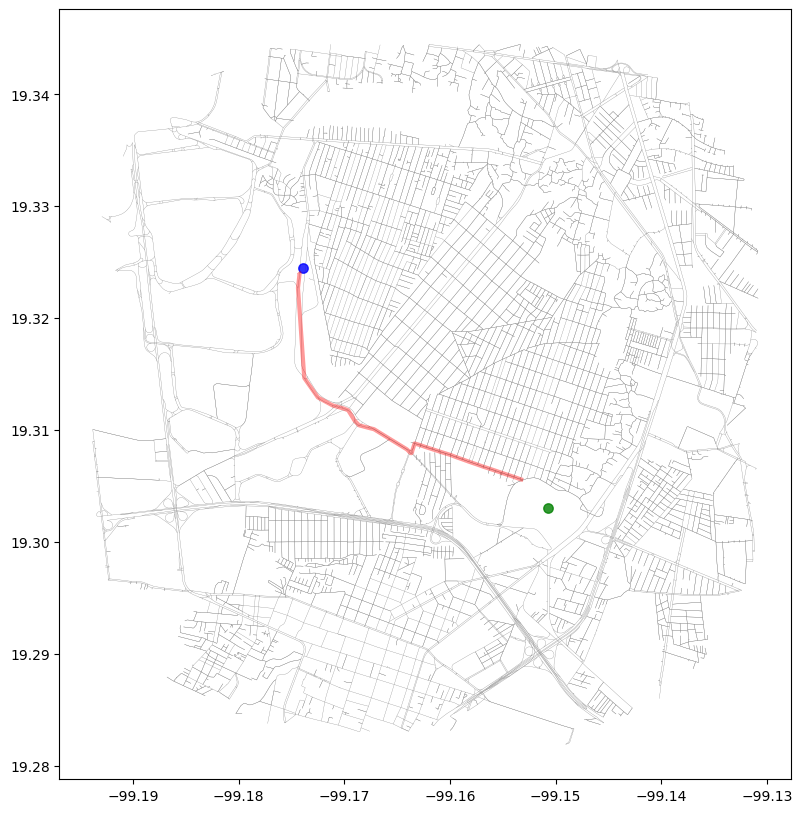

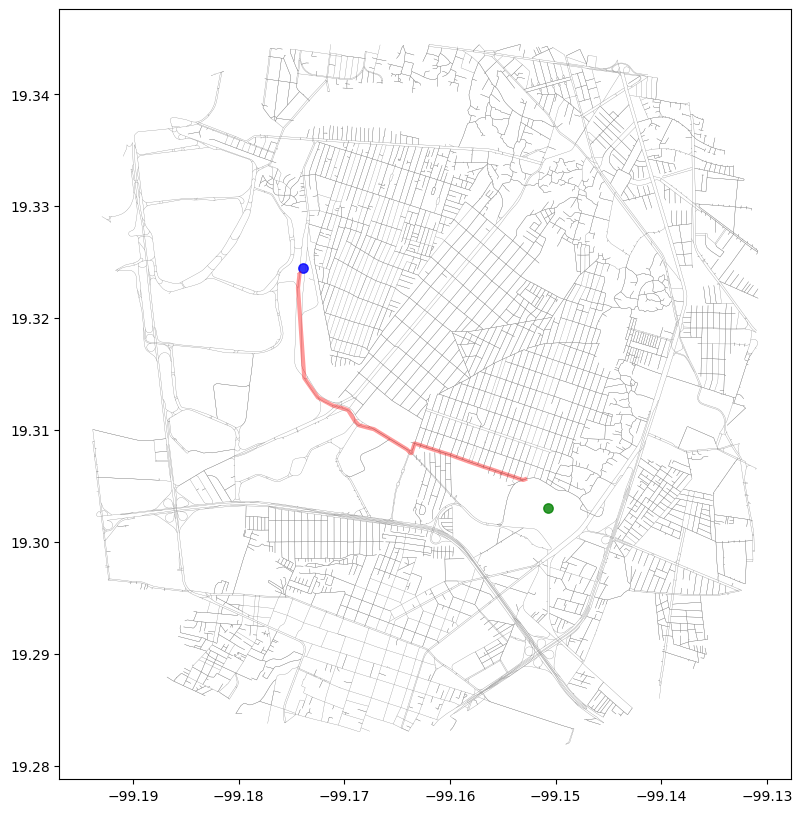

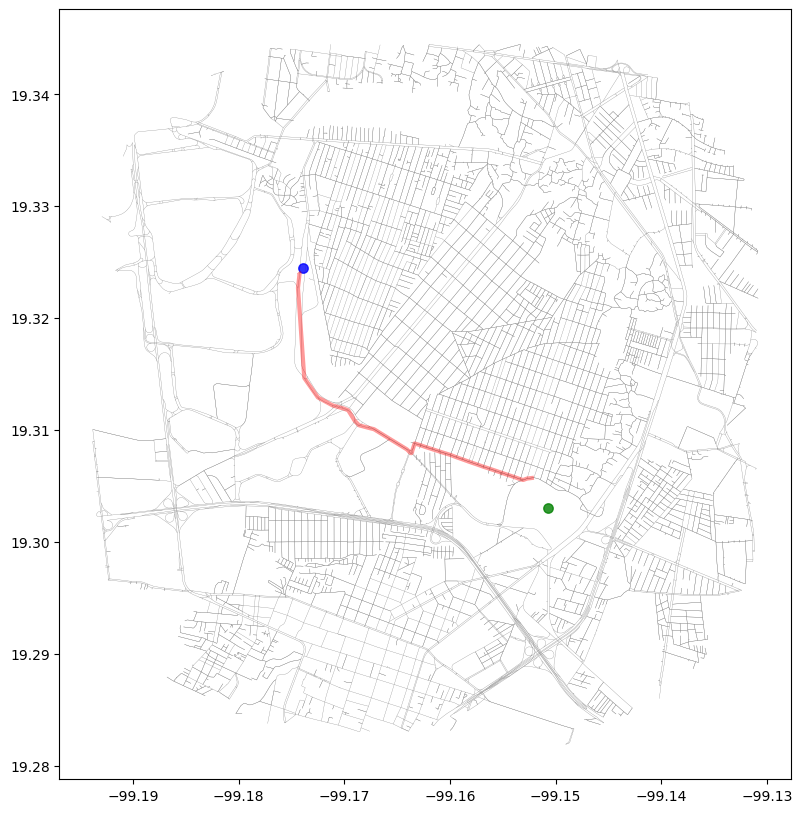

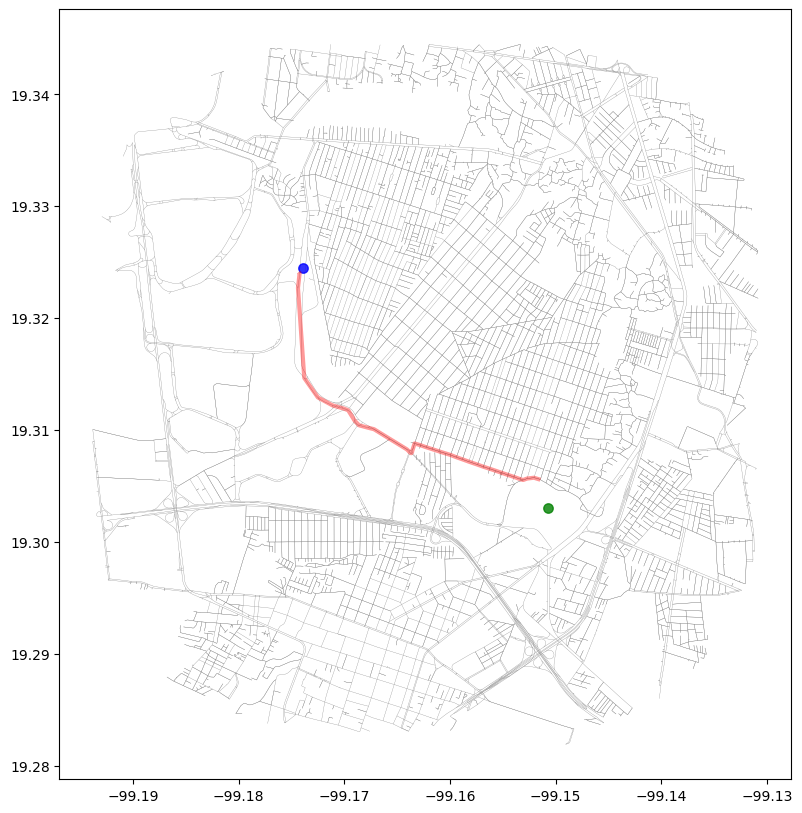

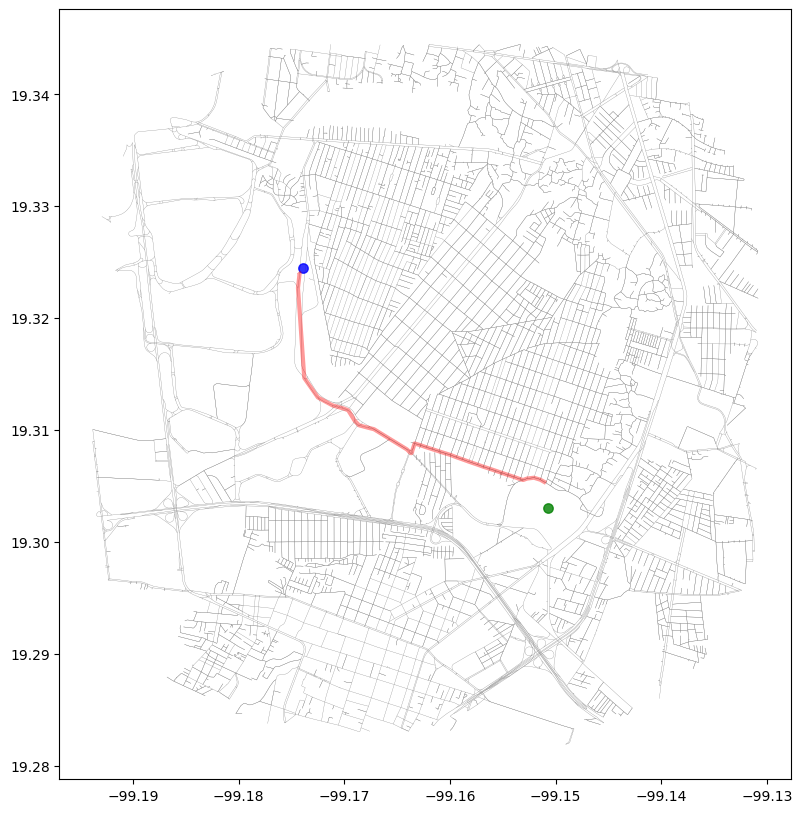

In [ ]:
# get all network nodes


# get the line geometries from osm nodes


for i in puntos.keys():
  graph_nodes = ox.graph_to_gdfs(graph, edges=False)
  # run
  route = ox.shortest_path(graph,
                         orig = closest_origin_node,
                         dest = closest_destination_node,
                         weight = 'length')
#route
  route_gdf = nodes_to_route(graph_nodes, route)
  # calculate distance m
  route_distance_gdf = compute_distance(route_gdf)
  # fetch network
  network = ox.graph_to_gdfs(graph, nodes=False)

  # get only needed columns
  network_gdf = network.reset_index(drop=True)[['geometry']]

  network_gdf.to_file(r'osm_network.gpkg')
  route_distance_gdf.to_file(r'osm_shortest_path.gpkg')

  # plot network
  ax = network_gdf.plot(figsize=(12, 10), linewidth = 0.2, color='grey', zorder=0);

  # origin and destination
  origin.plot(ax=ax, markersize=46, alpha=0.8, color='blue', zorder=1)
  destination.plot(ax=ax, markersize=46, alpha=0.8, color='green', zorder=2)

  # route
  route_distance_gdf.plot(ax=ax, linewidth = 3, color='red', alpha=0.4, zorder=3)

  #plt.axis(False);
  plt.savefig(f"{i}")

In [ ]:
!pip install opencv-python pillow

In [ ]:
!pwd

/content


In [ ]:
#ignorar esto pls

# Importing libraries
import os
import cv2
from PIL import Image

# Set path to the Google Drive folder with images
path = "/content"
os.chdir(path)

mean_height = 0
mean_width = 0

# Counting the number of images in the directory
num_of_images = len([file for file in os.listdir('.') if file.endswith((".jpg", ".jpeg", ".png"))])
print("Number of Images:", num_of_images)

# Calculating the mean width and height of all images
for file in os.listdir('.'):
    if file.endswith(".jpg") or file.endswith(".jpeg") or file.endswith("png"):

        im = Image.open(os.path.join(path, file))
        width, height = im.size
        mean_width += width
        mean_height += height

# Averaging width and height
mean_width = int(mean_width / num_of_images)
mean_height = int(mean_height / num_of_images)

# Resizing all images to the mean width and height
for file in os.listdir('.'):
    if file.endswith(".jpg") or file.endswith(".jpeg") or file.endswith("png"):
        im = Image.open(os.path.join(path, file))
        # Use Image.LANCZOS instead of Image.ANTIALIAS for downsampling
        im_resized = im.resize((mean_width, mean_height), Image.LANCZOS)
        im_resized.save(file, 'JPEG', quality=95)
        print(f"{file} is resized")


# Function to generate video
def generate_video():
    image_folder = path
    video_name = 'mygeneratedvideo.avi'

    images = [img for img in os.listdir(image_folder) if img.endswith((".jpg", ".jpeg", ".png"))]
    print("Images:", images)

    # Set frame from the first image
    frame = cv2.imread(os.path.join(image_folder, images[0]))
    height, width, layers = frame.shape

    # Video writer to create .avi file
    video = cv2.VideoWriter(video_name, cv2.VideoWriter_fourcc(*'DIVX'), 1, (width, height))

    # Appending images to video
    for image in images:
        video.write(cv2.imread(os.path.join(image_folder, image)))

    # Release the video file
    video.release()
    cv2.destroyAllWindows()
    print("Video generated successfully!")

# Calling the function to generate the video
generate_video()


Number of Images: 47


UnidentifiedImageError: cannot identify image file '/content/2.png'